In [11]:
# This Notebook was inspired by Medium's Sebastian Theiler: https://medium.com/analytics-vidhya/implementing-a-gan-in-keras-d6c36bc6ab5f

In [12]:
# Neccessary imports
import os

import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
from keras.initializers import RandomNormal
from keras.datasets import cifar10, mnist
from keras.layers import (BatchNormalization, Conv2D, Conv2DTranspose, Dense,
                          Dropout, Flatten, Input, Reshape, UpSampling2D,
                          ZeroPadding2D)
from keras.layers.advanced_activations import LeakyReLU
from keras.models import Model, Sequential

%matplotlib inline

In [13]:
# Define random seed to have consistent results
np.random.seed(1337)

# The dimension of z
noise_dim = 100

batch_size = 16
steps_per_epoch = 312 # 50000 / 16
epochs = 800

img_rows, img_cols, channels = 32, 32, 3

optimizer = tf.keras.optimizers.Adam(learning_rate = 0.0002, beta_1=0.5)

In [14]:
# Path for saving images
save_path = 'dcgan-images'

# Create path for saving images
if save_path != None and not os.path.isdir(save_path):
    os.mkdir(save_path)

In [15]:
# Load and pre-process data
(x_train, y_train), (x_test, y_test) = cifar10.load_data()
# Normalize to between -1 and 1
x_train = (x_train.astype(np.float32) - 127.5) / 127.5

# Reshape and only save cat images
x_train = x_train[np.where(y_train == 0)[0]].reshape((-1, img_rows, img_cols, channels))

In [16]:
# Function that creates the generator
def create_generator():
    generator = Sequential()
    
    # Starting size
    d = 4
    generator.add(Dense(d*d*256, kernel_initializer=RandomNormal(0, 0.02), input_dim=noise_dim))
    generator.add(LeakyReLU(0.2))
    # 4x4x256
    generator.add(Reshape((d, d, 256)))
    
    # 8x8x128
    generator.add(Conv2DTranspose(128, (4, 4), strides=2, padding='same', kernel_initializer=RandomNormal(0, 0.02)))
    generator.add(LeakyReLU(0.2))
    
    # 16x16*128
    generator.add(Conv2DTranspose(128, (4, 4), strides=2, padding='same', kernel_initializer=RandomNormal(0, 0.02)))
    generator.add(LeakyReLU(0.2))
    
    # 32x32x128
    generator.add(Conv2DTranspose(128, (4, 4), strides=2, padding='same', kernel_initializer=RandomNormal(0, 0.02)))
    generator.add(LeakyReLU(0.2))
    
    # 32x32x3
    generator.add(Conv2D(channels, (3, 3), padding='same', activation='tanh', kernel_initializer=RandomNormal(0, 0.02)))
    
    generator.compile(loss='binary_crossentropy', optimizer=optimizer)
    return generator

In [17]:
# Function that creates the generator
def create_discriminator():
    discriminator = Sequential()
    
    discriminator.add(Conv2D(64, (3, 3), padding='same', kernel_initializer=RandomNormal(0, 0.02), input_shape=(img_cols, img_rows, channels)))
    discriminator.add(LeakyReLU(0.2))
    
    discriminator.add(Conv2D(128, (3, 3), strides=2, padding='same', kernel_initializer=RandomNormal(0, 0.02)))
    discriminator.add(LeakyReLU(0.2))
    
    discriminator.add(Conv2D(128, (3, 3), strides=2, padding='same', kernel_initializer=RandomNormal(0, 0.02)))
    discriminator.add(LeakyReLU(0.2))
    
    discriminator.add(Conv2D(256, (3, 3), strides=2, padding='same', kernel_initializer=RandomNormal(0, 0.02)))
    discriminator.add(LeakyReLU(0.2))
    
    discriminator.add(Flatten())
    discriminator.add(Dropout(0.4))
    discriminator.add(Dense(1, activation='sigmoid', input_shape=(img_cols, img_rows, channels)))
    
    discriminator.compile(loss='binary_crossentropy', optimizer=optimizer)
    return discriminator

In [18]:
# Create the discriminator and generator
discriminator = create_discriminator()
generator = create_generator()

# Make the discriminator untrainable when we are training the generator.  This doesn't effect the discriminator by itself
discriminator.trainable = False

# Link the two models to create the GAN
gan_input = Input(shape=(noise_dim,))
fake_image = generator(gan_input)

gan_output = discriminator(fake_image)

gan = Model(gan_input, gan_output)
gan.compile(loss='binary_crossentropy', optimizer=optimizer)

In [19]:
# Display images, and save them if the epoch number is specified
def show_images(noise, epoch=None):
    generated_images = generator.predict(noise)
    plt.figure(figsize=(10, 10))
    
    for i, image in enumerate(generated_images):
        plt.subplot(10, 10, i+1)
        if channels == 1:
            plt.imshow(np.clip(image.reshape((img_rows, img_cols)), 0.0, 1.0), cmap='gray')
        else:
            plt.imshow(np.clip(image.reshape((img_rows, img_cols, channels)), 0.0, 1.0))
        plt.axis('off')
    
    plt.tight_layout()
    
    if epoch != None and save_path != None:
        plt.savefig(f'{save_path}/gan-images_epoch-{epoch}.png')
    plt.show()

Epoch: 0 	 Discriminator Loss: 0.5352337956428528 		 Generator Loss: 1.485487699508667


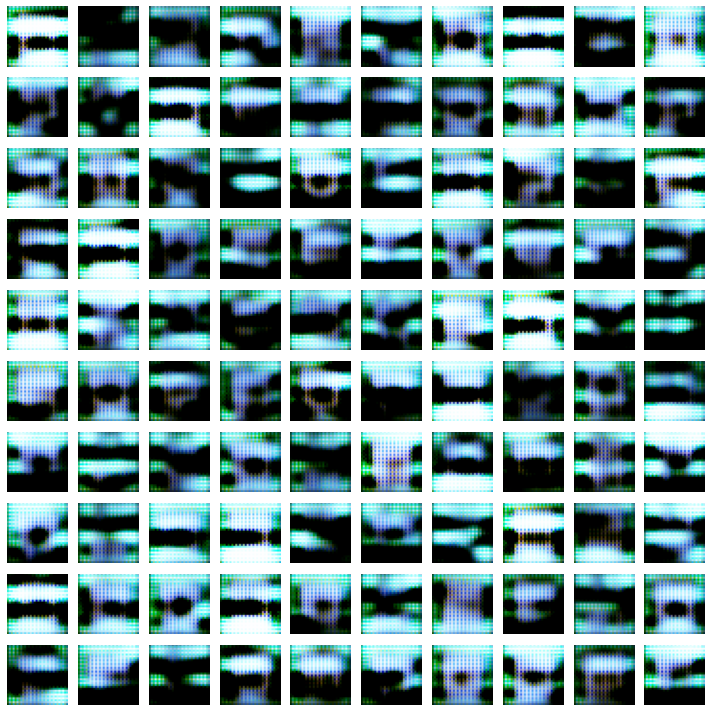

Epoch: 1 	 Discriminator Loss: 0.5530601739883423 		 Generator Loss: 1.389125943183899
Epoch: 2 	 Discriminator Loss: 0.4896937608718872 		 Generator Loss: 1.4593009948730469


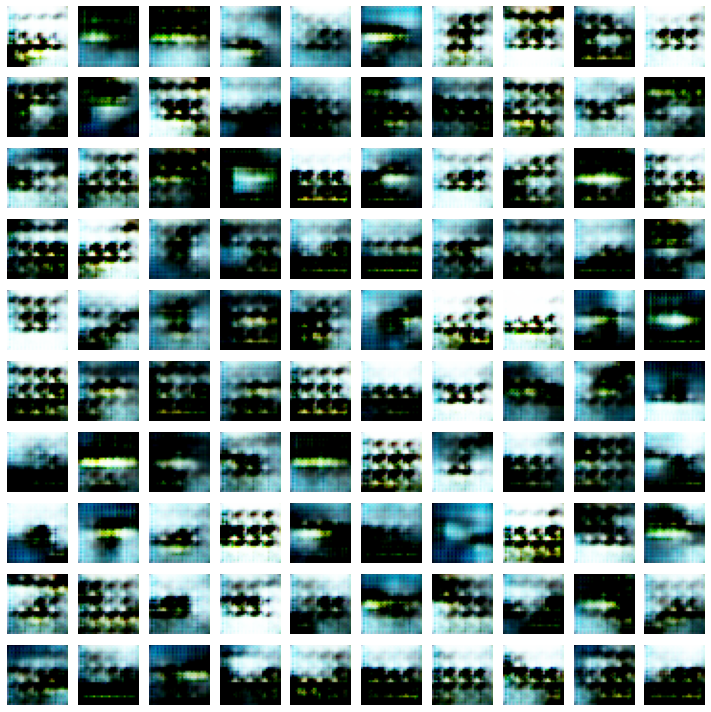

Epoch: 3 	 Discriminator Loss: 0.6310458779335022 		 Generator Loss: 1.461150050163269
Epoch: 4 	 Discriminator Loss: 0.5402059555053711 		 Generator Loss: 1.3085048198699951


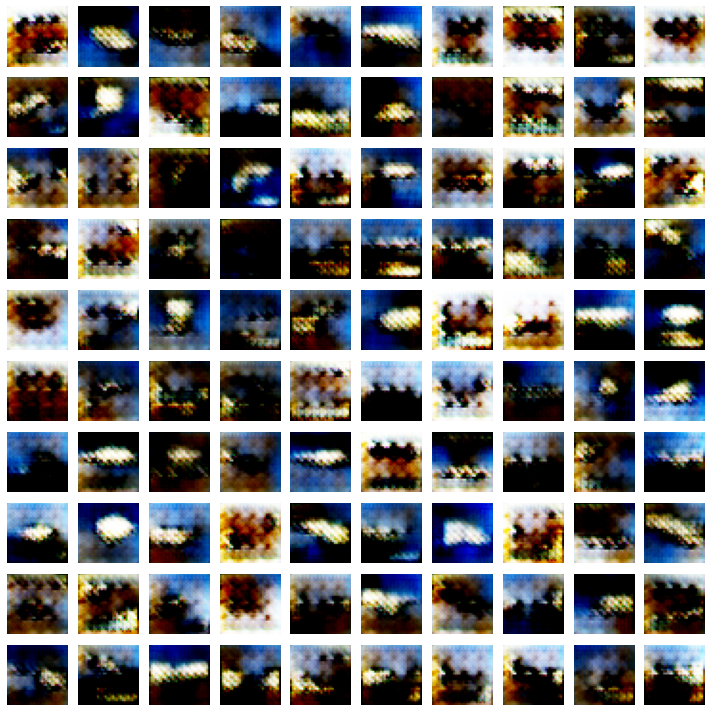

Epoch: 5 	 Discriminator Loss: 0.6140608787536621 		 Generator Loss: 0.9672510027885437
Epoch: 6 	 Discriminator Loss: 0.6017743349075317 		 Generator Loss: 1.1451325416564941


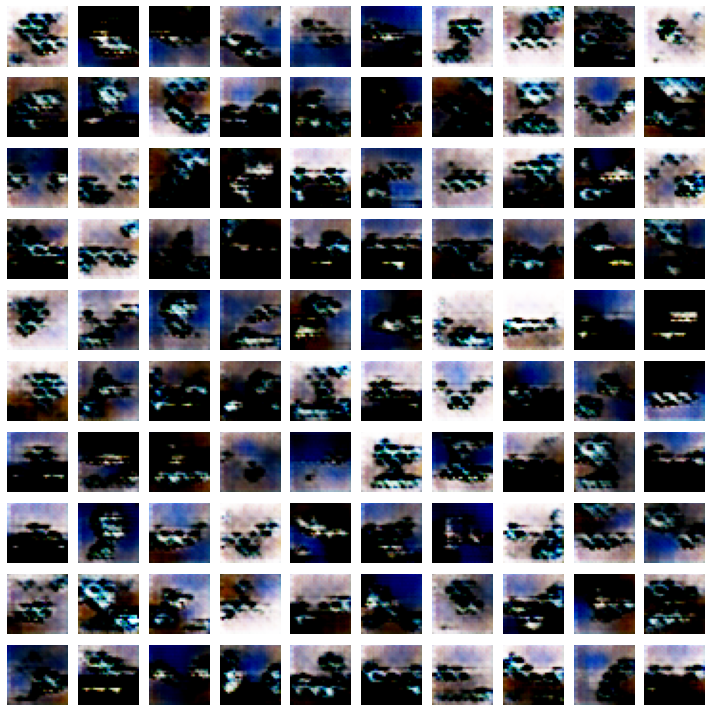

Epoch: 7 	 Discriminator Loss: 0.554720401763916 		 Generator Loss: 1.403855562210083
Epoch: 8 	 Discriminator Loss: 0.6012877225875854 		 Generator Loss: 1.0537607669830322


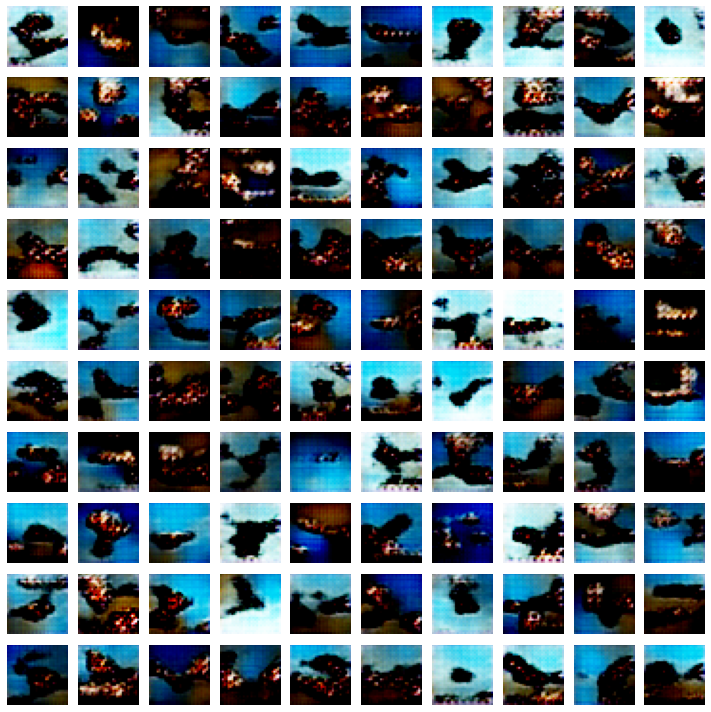

Epoch: 9 	 Discriminator Loss: 0.5894976258277893 		 Generator Loss: 1.140405535697937
Epoch: 10 	 Discriminator Loss: 0.7599263191223145 		 Generator Loss: 1.0329095125198364


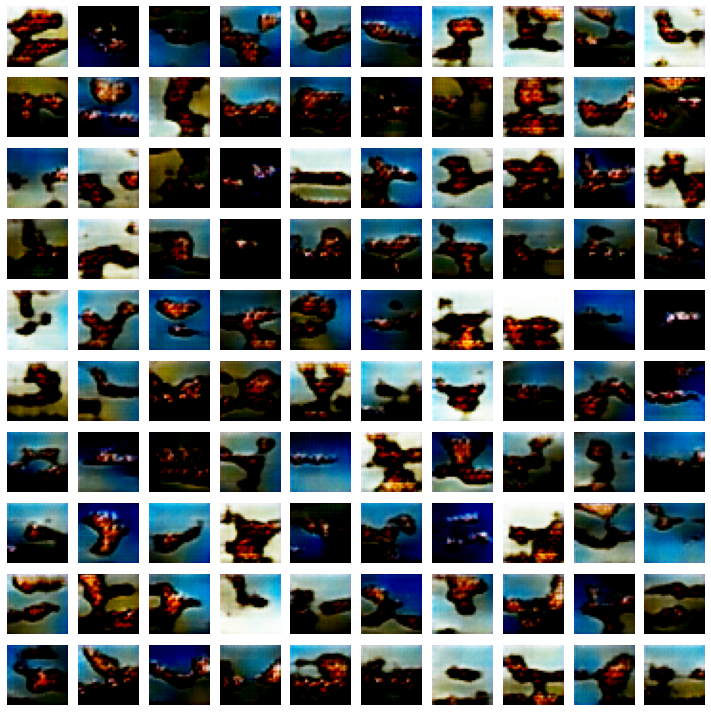

Epoch: 11 	 Discriminator Loss: 0.5780559778213501 		 Generator Loss: 1.1007851362228394
Epoch: 12 	 Discriminator Loss: 0.5959463715553284 		 Generator Loss: 1.0823757648468018


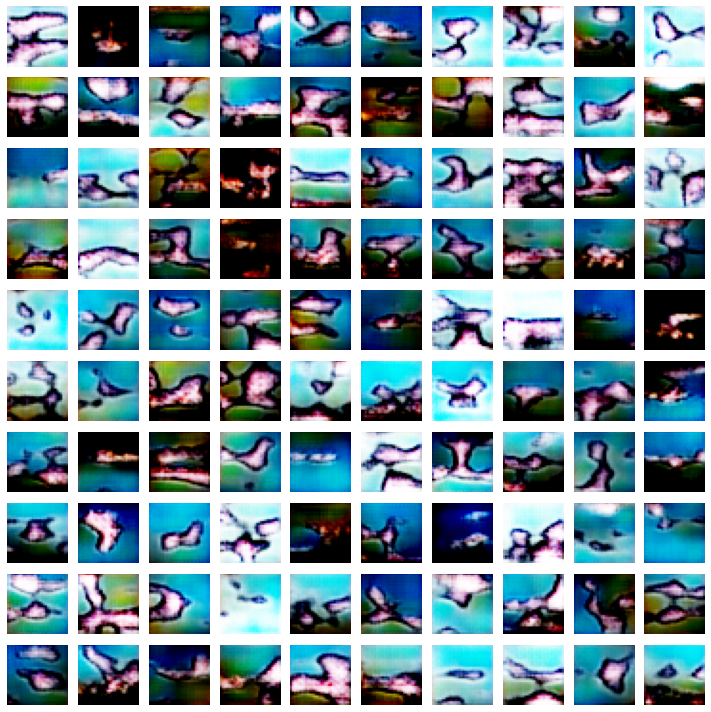

Epoch: 13 	 Discriminator Loss: 0.6007205247879028 		 Generator Loss: 0.9296706914901733
Epoch: 14 	 Discriminator Loss: 0.5894306898117065 		 Generator Loss: 0.9499992728233337


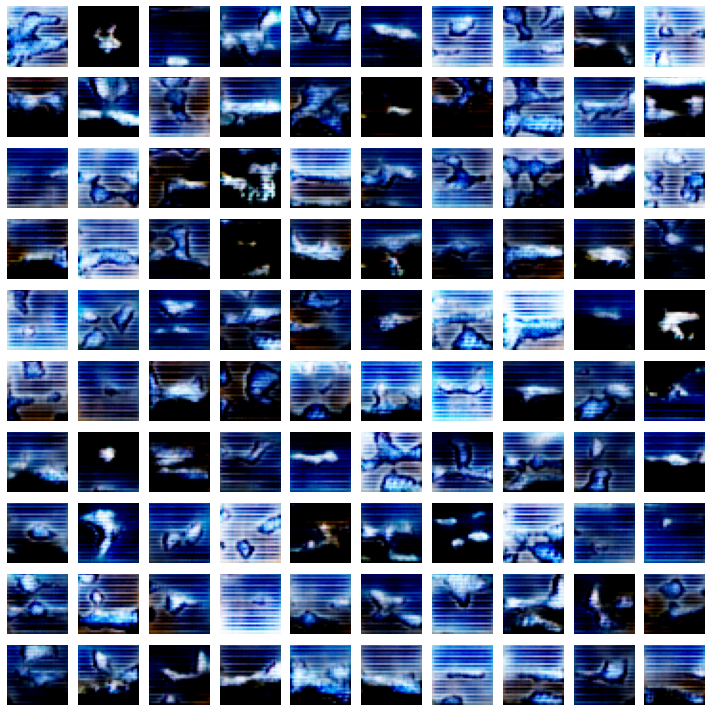

Epoch: 15 	 Discriminator Loss: 0.5822860598564148 		 Generator Loss: 1.1903979778289795
Epoch: 16 	 Discriminator Loss: 0.6304460167884827 		 Generator Loss: 0.9649248123168945


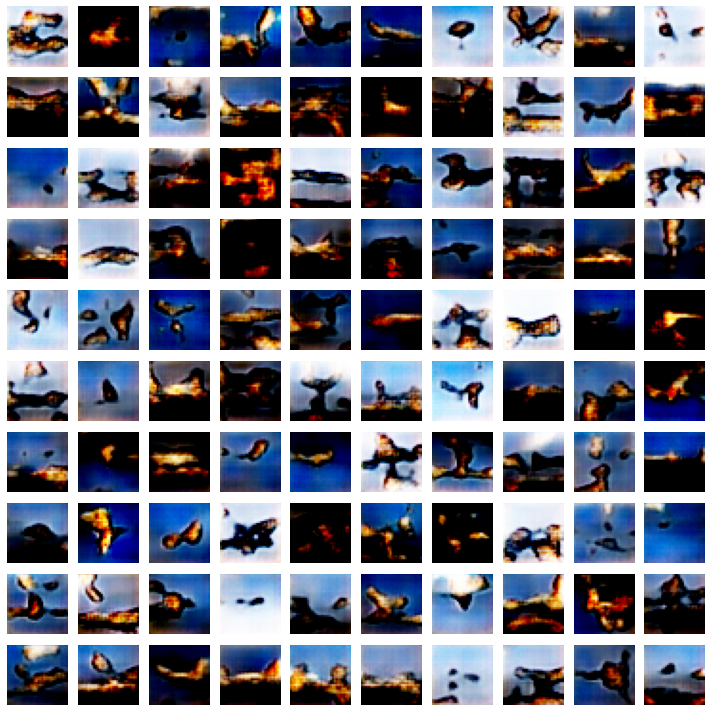

Epoch: 17 	 Discriminator Loss: 0.542428731918335 		 Generator Loss: 1.1673719882965088
Epoch: 18 	 Discriminator Loss: 0.5602202415466309 		 Generator Loss: 1.1690289974212646


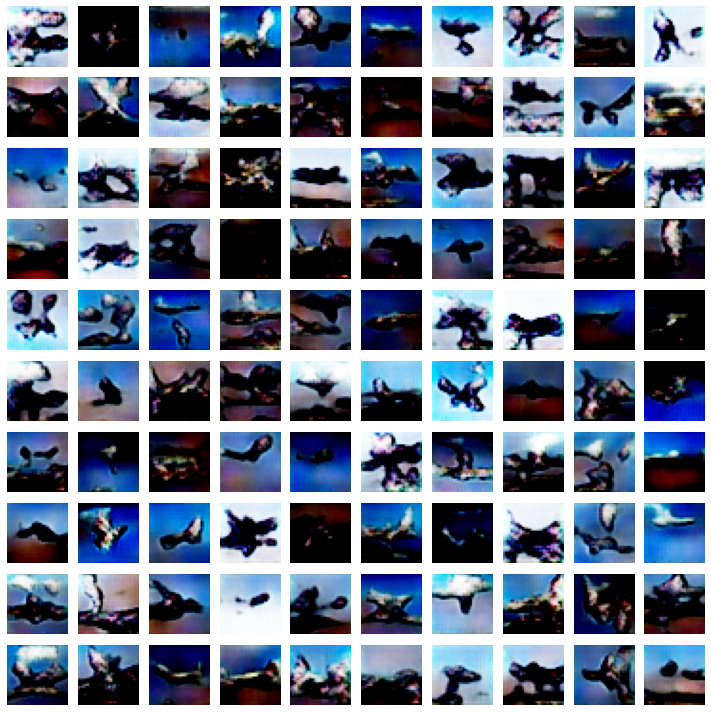

Epoch: 19 	 Discriminator Loss: 0.5755018591880798 		 Generator Loss: 1.1834204196929932
Epoch: 20 	 Discriminator Loss: 0.5666396021842957 		 Generator Loss: 0.9884107112884521


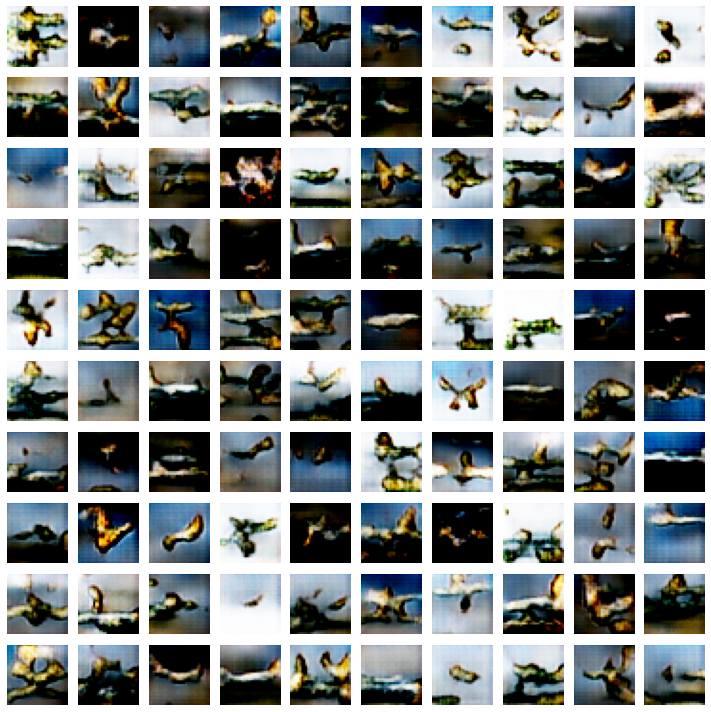

Epoch: 21 	 Discriminator Loss: 0.6454517245292664 		 Generator Loss: 1.0468649864196777
Epoch: 22 	 Discriminator Loss: 0.6042467355728149 		 Generator Loss: 1.3648896217346191


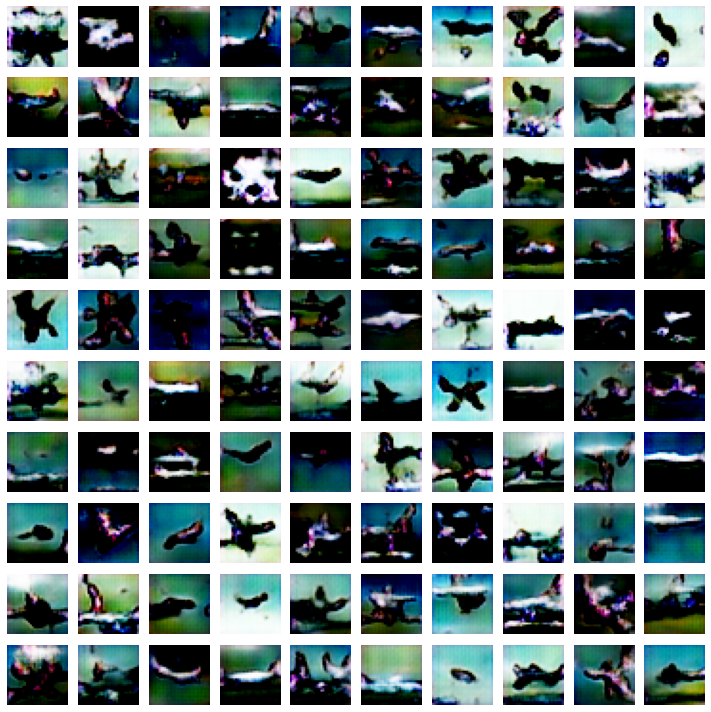

Epoch: 23 	 Discriminator Loss: 0.6166896820068359 		 Generator Loss: 1.2017451524734497
Epoch: 24 	 Discriminator Loss: 0.5339336395263672 		 Generator Loss: 1.3032701015472412


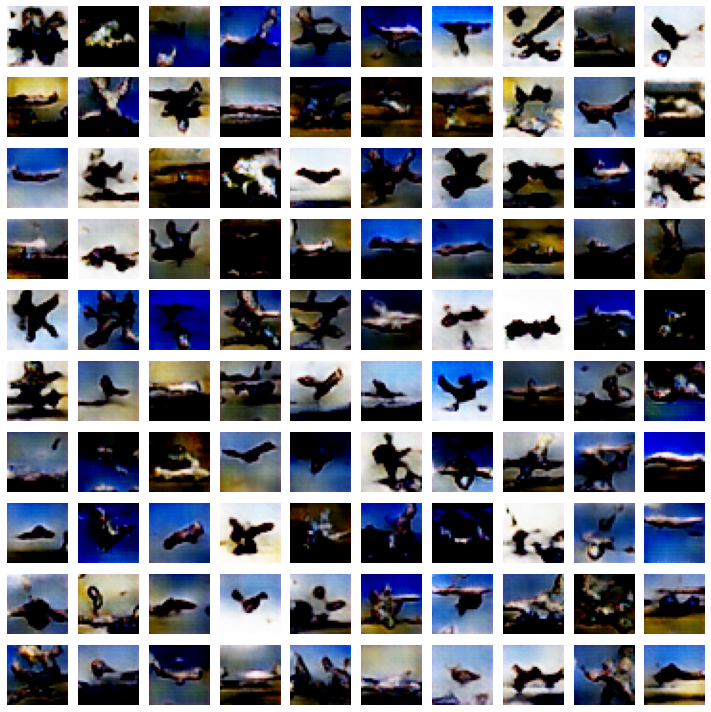

Epoch: 25 	 Discriminator Loss: 0.6102472543716431 		 Generator Loss: 1.2409040927886963
Epoch: 26 	 Discriminator Loss: 0.5894005298614502 		 Generator Loss: 1.4477702379226685


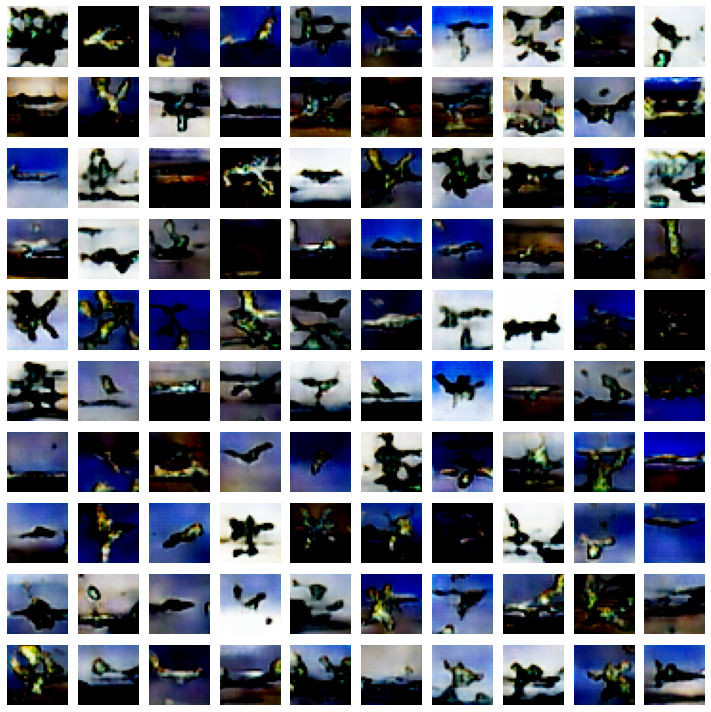

Epoch: 27 	 Discriminator Loss: 0.5852961540222168 		 Generator Loss: 1.1829307079315186
Epoch: 28 	 Discriminator Loss: 0.6148908138275146 		 Generator Loss: 1.145576000213623


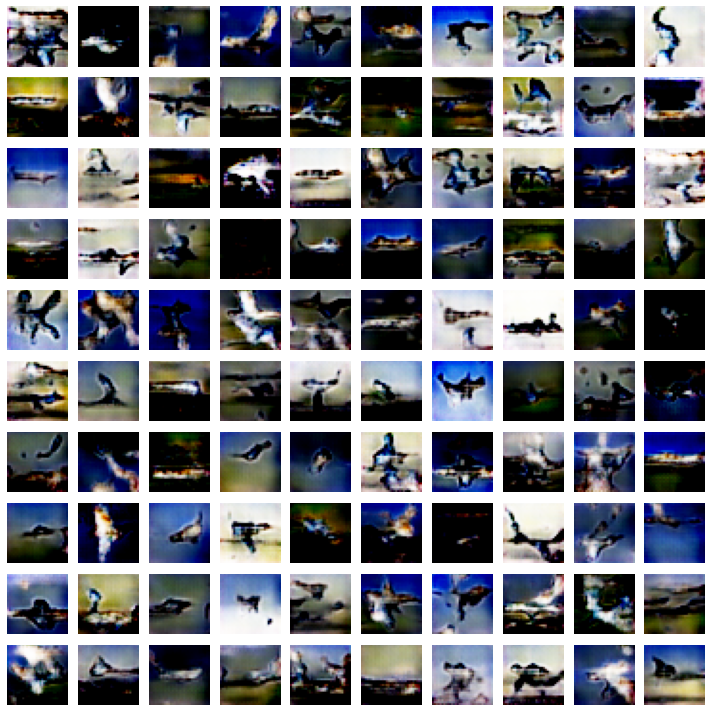

Epoch: 29 	 Discriminator Loss: 0.5988411903381348 		 Generator Loss: 1.1826690435409546
Epoch: 30 	 Discriminator Loss: 0.6869508028030396 		 Generator Loss: 1.776037335395813


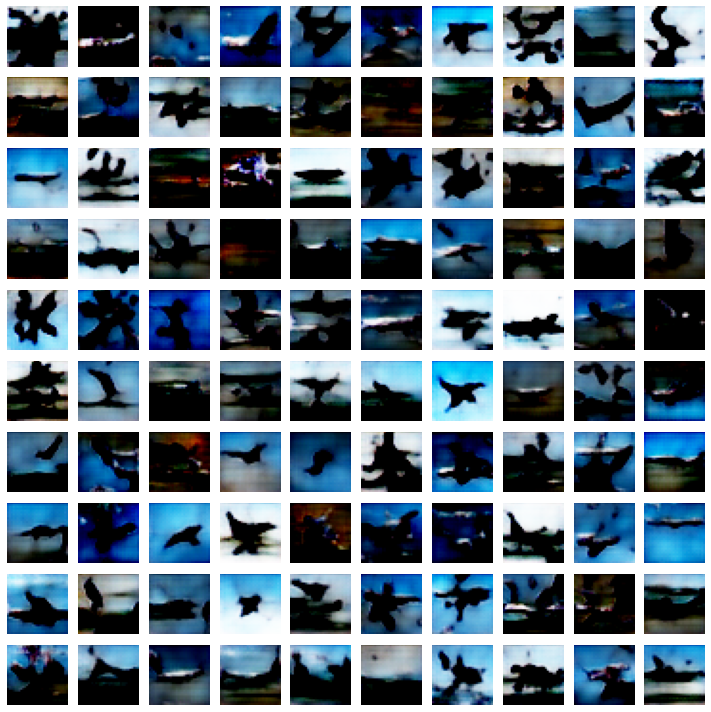

Epoch: 31 	 Discriminator Loss: 0.6142824292182922 		 Generator Loss: 1.056474208831787
Epoch: 32 	 Discriminator Loss: 0.5377840995788574 		 Generator Loss: 1.150059700012207


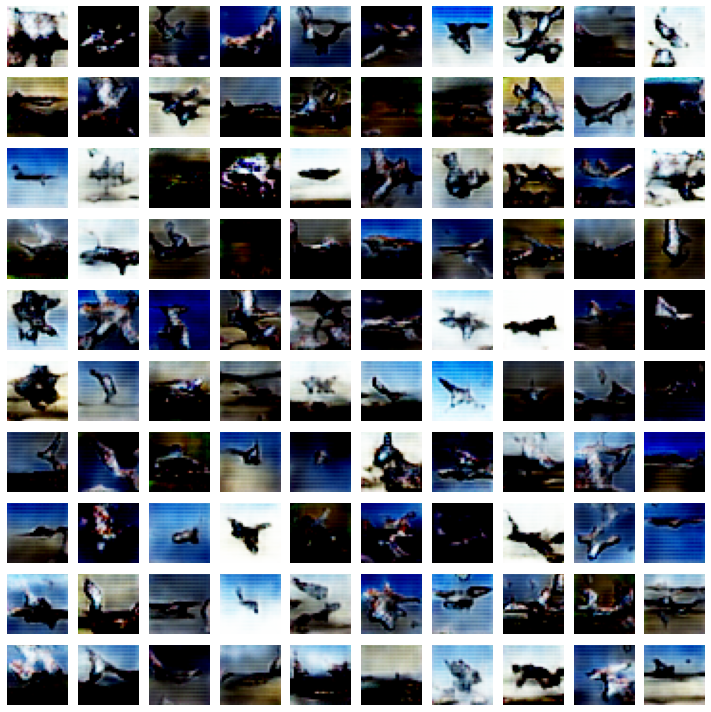

Epoch: 33 	 Discriminator Loss: 0.5535216331481934 		 Generator Loss: 1.3449492454528809
Epoch: 34 	 Discriminator Loss: 0.6258982419967651 		 Generator Loss: 1.338510274887085


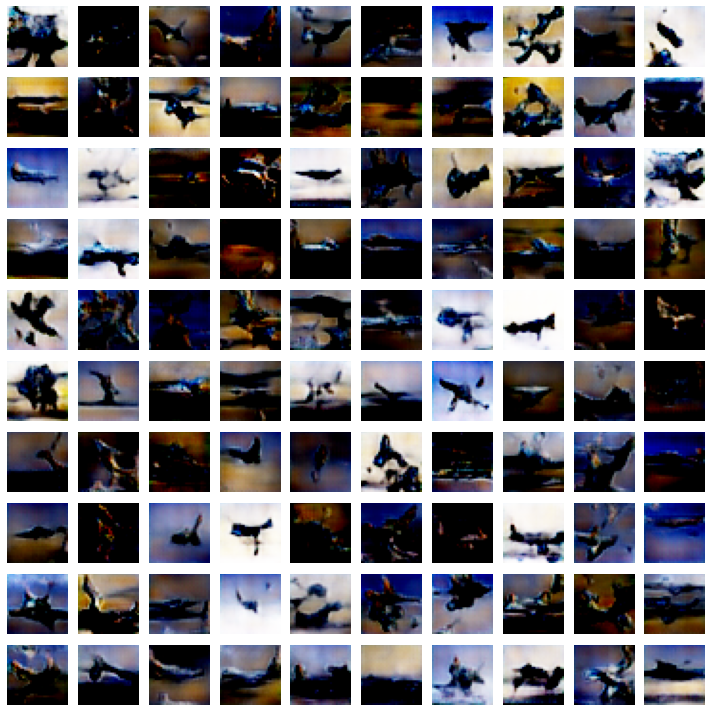

Epoch: 35 	 Discriminator Loss: 0.4983925521373749 		 Generator Loss: 1.591787576675415
Epoch: 36 	 Discriminator Loss: 0.5786898136138916 		 Generator Loss: 1.2847237586975098


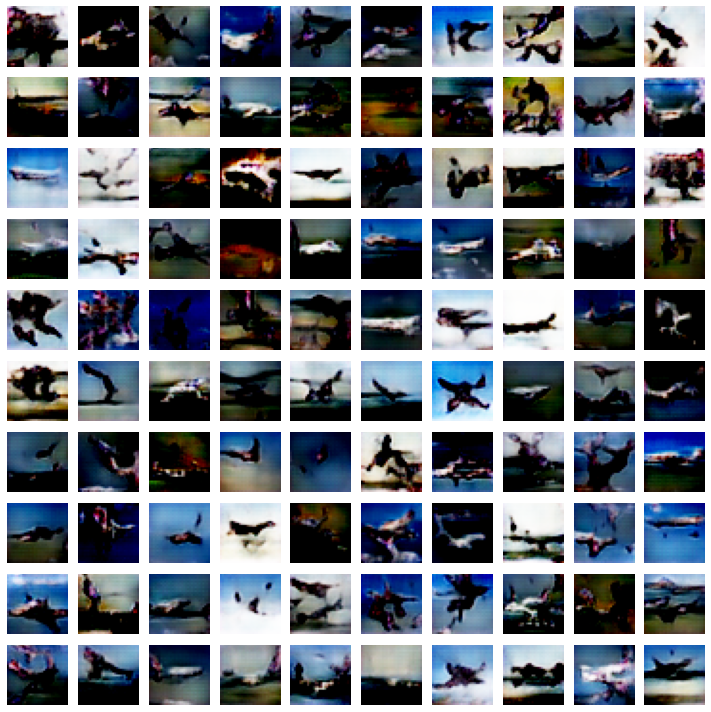

Epoch: 37 	 Discriminator Loss: 0.5552427768707275 		 Generator Loss: 1.3820617198944092
Epoch: 38 	 Discriminator Loss: 0.541810154914856 		 Generator Loss: 1.5769439935684204


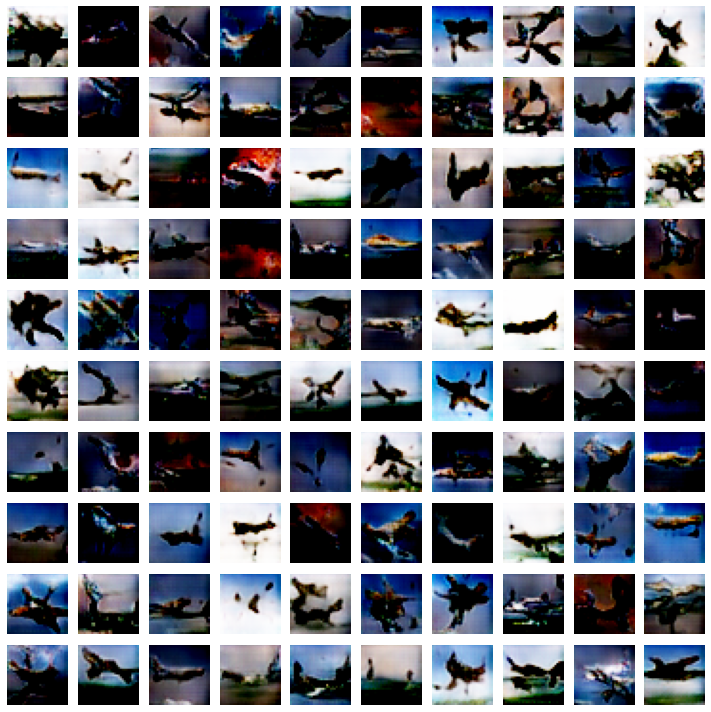

Epoch: 39 	 Discriminator Loss: 0.4899570643901825 		 Generator Loss: 1.2969658374786377
Epoch: 40 	 Discriminator Loss: 0.5188075304031372 		 Generator Loss: 1.4463242292404175


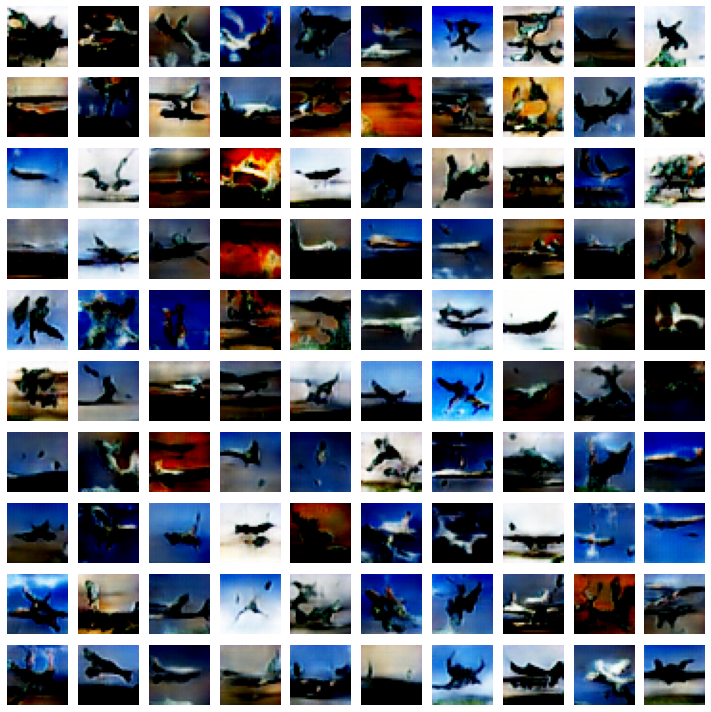

Epoch: 41 	 Discriminator Loss: 0.5416142344474792 		 Generator Loss: 1.5031282901763916
Epoch: 42 	 Discriminator Loss: 0.5359091758728027 		 Generator Loss: 1.2935726642608643


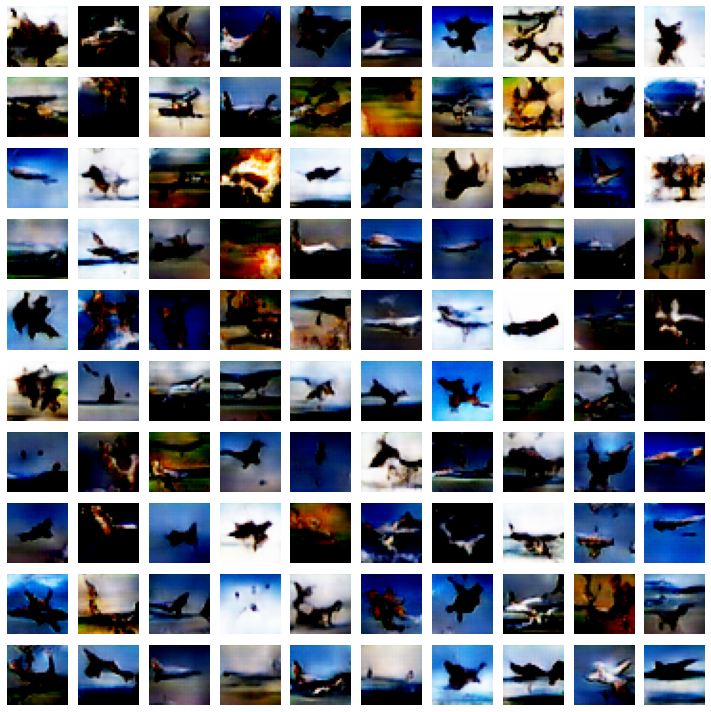

Epoch: 43 	 Discriminator Loss: 0.49915042519569397 		 Generator Loss: 1.461925745010376
Epoch: 44 	 Discriminator Loss: 0.5837953090667725 		 Generator Loss: 1.00722336769104


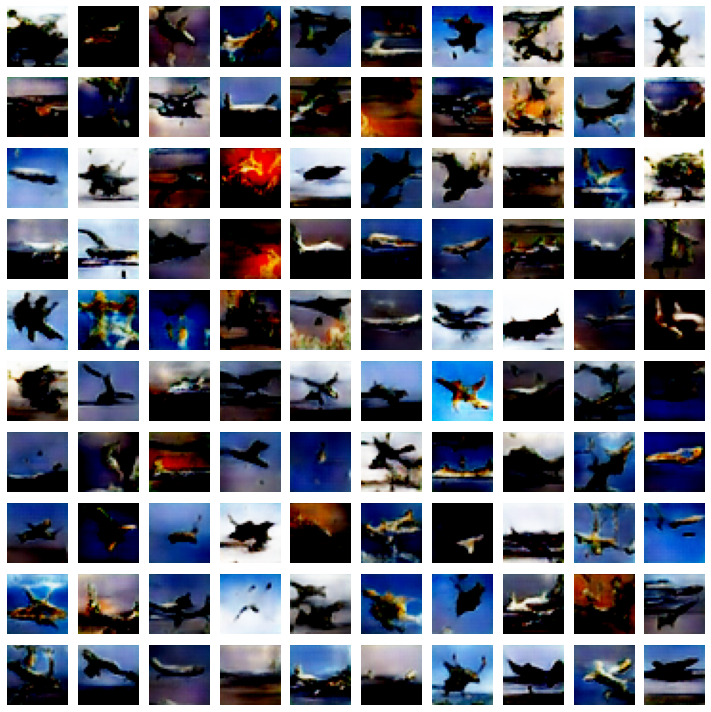

Epoch: 45 	 Discriminator Loss: 0.47615760564804077 		 Generator Loss: 1.230168104171753
Epoch: 46 	 Discriminator Loss: 0.5663958787918091 		 Generator Loss: 1.6412760019302368


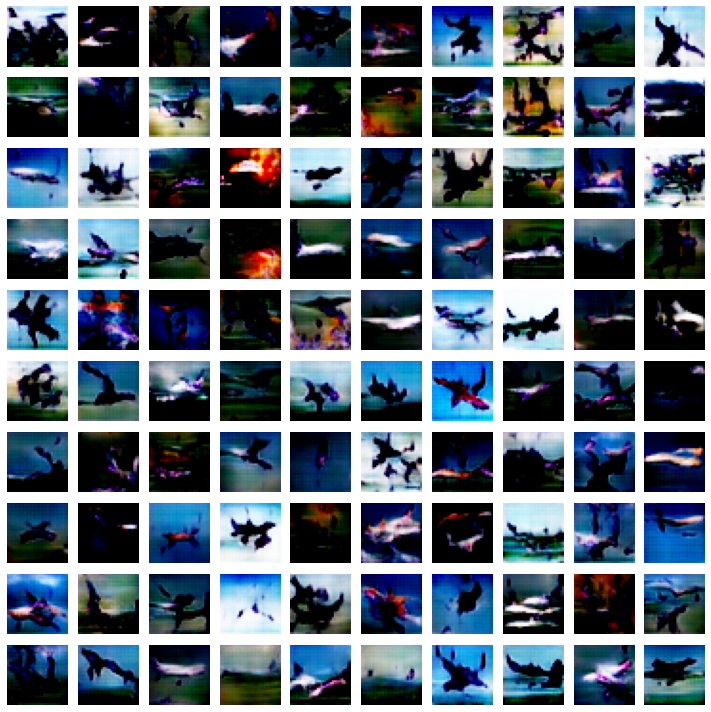

Epoch: 47 	 Discriminator Loss: 0.483196496963501 		 Generator Loss: 1.4523696899414062
Epoch: 48 	 Discriminator Loss: 0.4177277386188507 		 Generator Loss: 1.8279973268508911


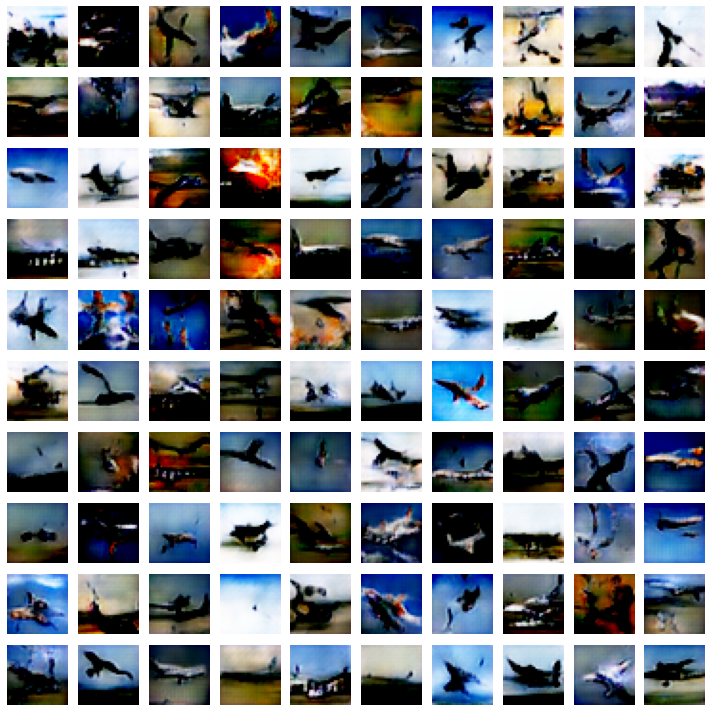

Epoch: 49 	 Discriminator Loss: 0.44166797399520874 		 Generator Loss: 1.528175950050354
Epoch: 50 	 Discriminator Loss: 0.5141633152961731 		 Generator Loss: 1.493743658065796


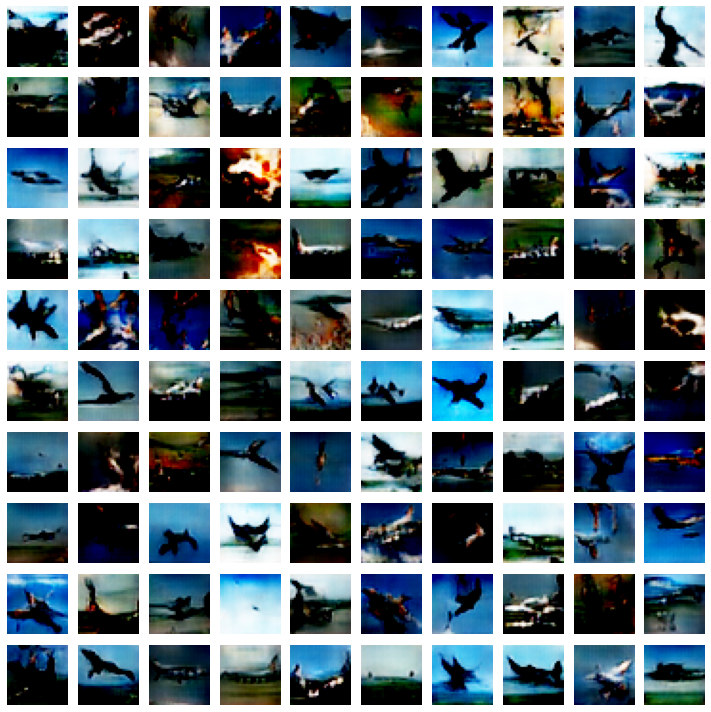

Epoch: 51 	 Discriminator Loss: 0.5848456621170044 		 Generator Loss: 1.6158721446990967
Epoch: 52 	 Discriminator Loss: 0.5184816122055054 		 Generator Loss: 1.555751085281372


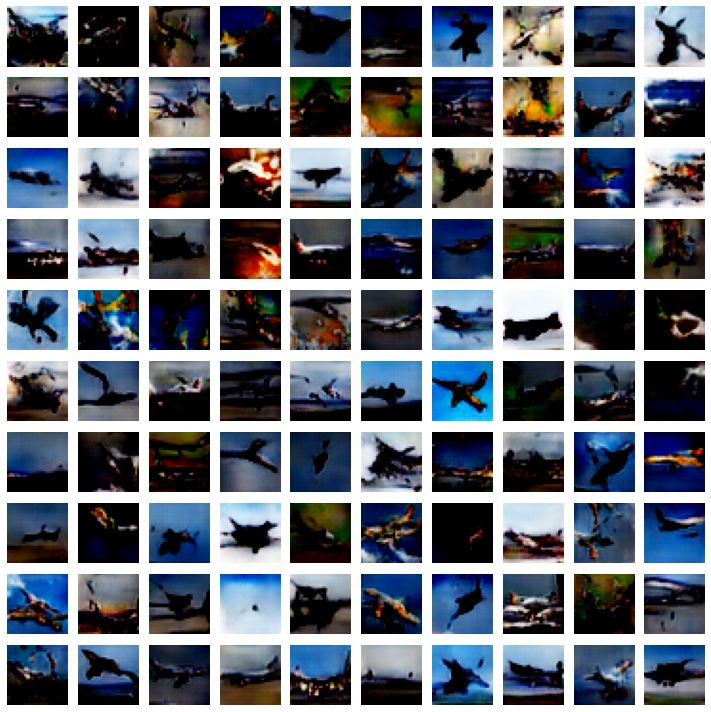

Epoch: 53 	 Discriminator Loss: 0.5618003606796265 		 Generator Loss: 1.492685079574585
Epoch: 54 	 Discriminator Loss: 0.5246432423591614 		 Generator Loss: 1.725199818611145


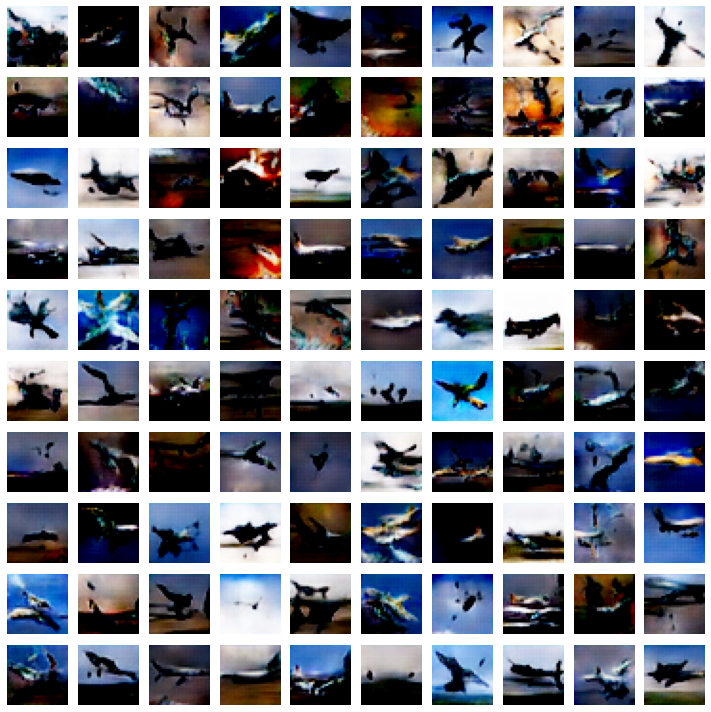

Epoch: 55 	 Discriminator Loss: 0.6624438762664795 		 Generator Loss: 1.6335995197296143
Epoch: 56 	 Discriminator Loss: 0.5056785941123962 		 Generator Loss: 1.4267359972000122


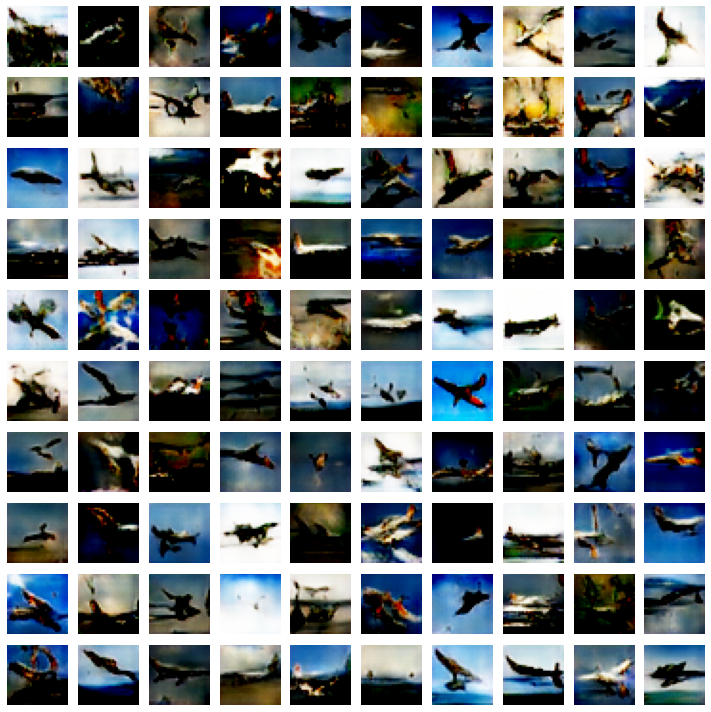

Epoch: 57 	 Discriminator Loss: 0.463437557220459 		 Generator Loss: 1.4337302446365356
Epoch: 58 	 Discriminator Loss: 0.5842508673667908 		 Generator Loss: 1.6774073839187622


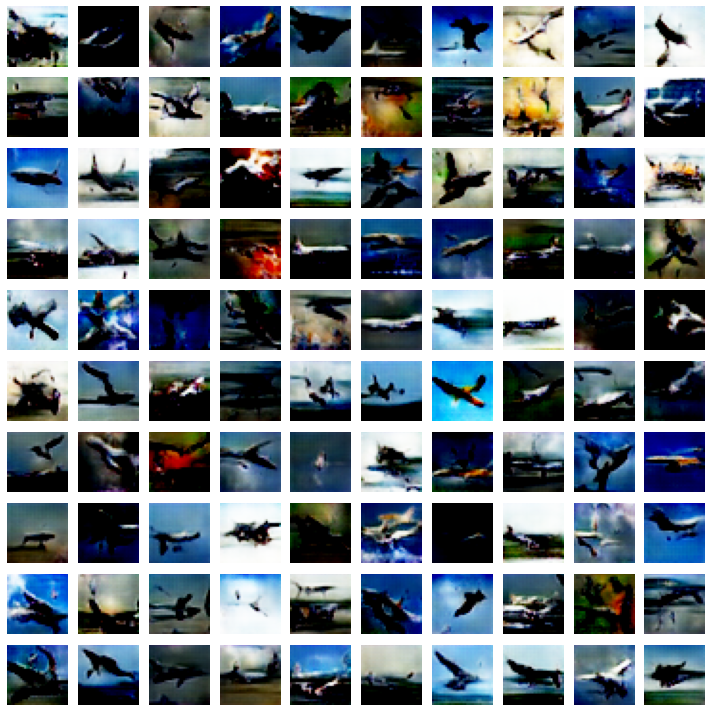

Epoch: 59 	 Discriminator Loss: 0.6033772826194763 		 Generator Loss: 1.5881390571594238
Epoch: 60 	 Discriminator Loss: 0.5274732112884521 		 Generator Loss: 1.8118791580200195


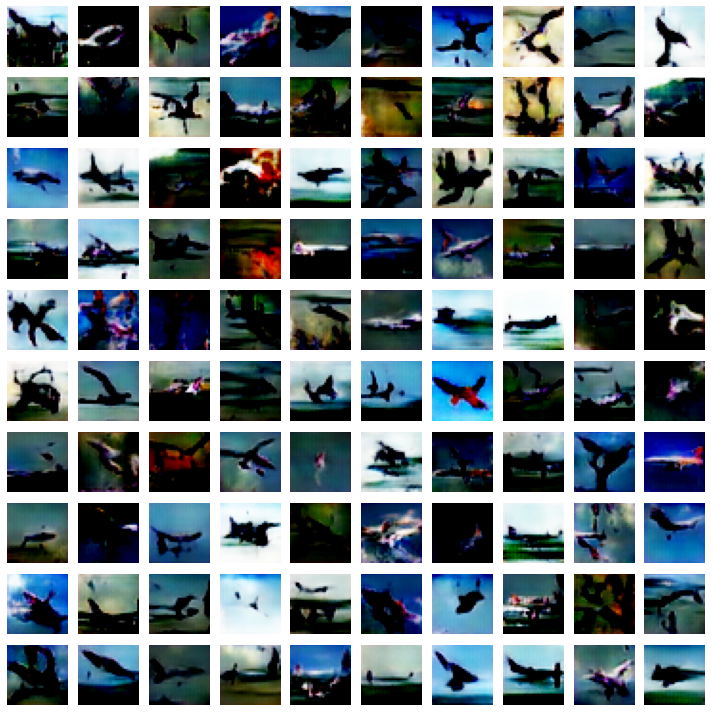

Epoch: 61 	 Discriminator Loss: 0.33639460802078247 		 Generator Loss: 1.9615323543548584
Epoch: 62 	 Discriminator Loss: 0.626313328742981 		 Generator Loss: 1.4640997648239136


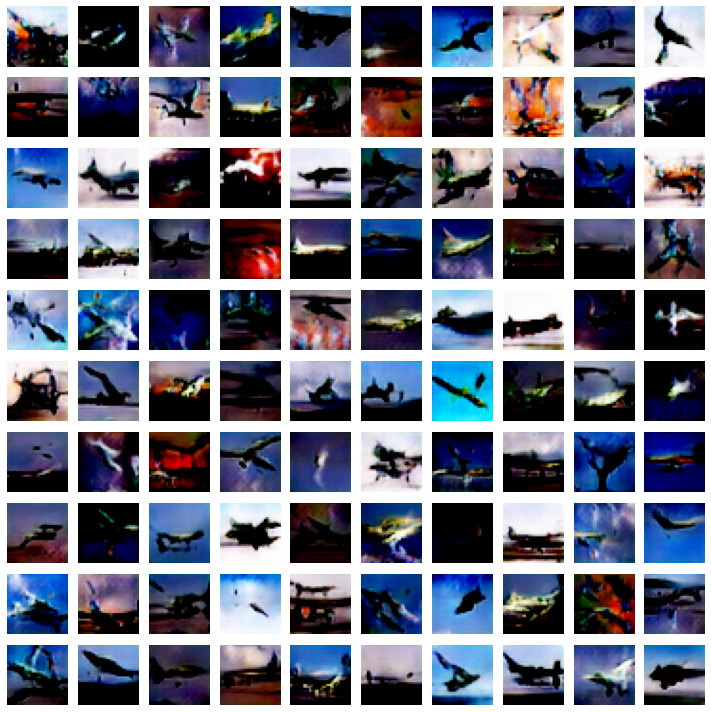

Epoch: 63 	 Discriminator Loss: 0.531714141368866 		 Generator Loss: 1.5767452716827393
Epoch: 64 	 Discriminator Loss: 0.4794953465461731 		 Generator Loss: 1.52971613407135


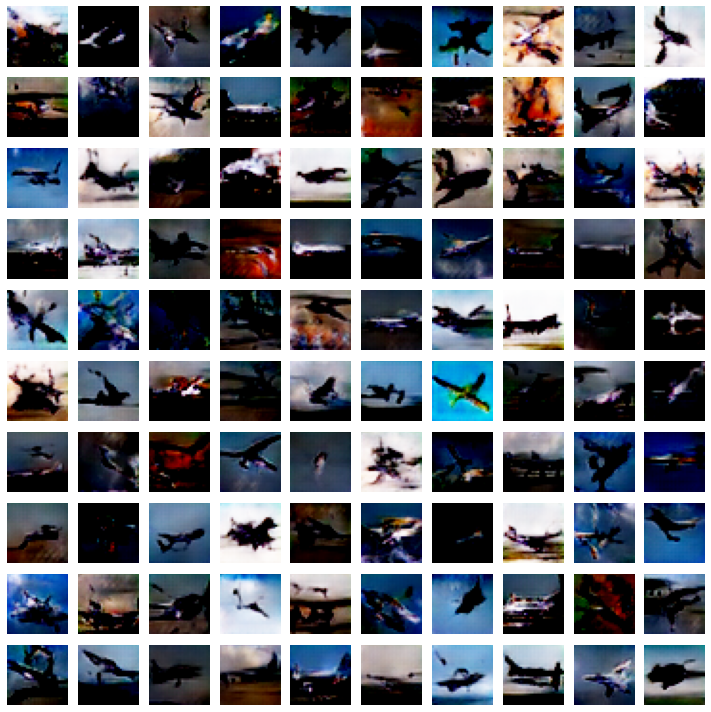

Epoch: 65 	 Discriminator Loss: 0.5585652589797974 		 Generator Loss: 1.837799072265625
Epoch: 66 	 Discriminator Loss: 0.48141559958457947 		 Generator Loss: 1.5153982639312744


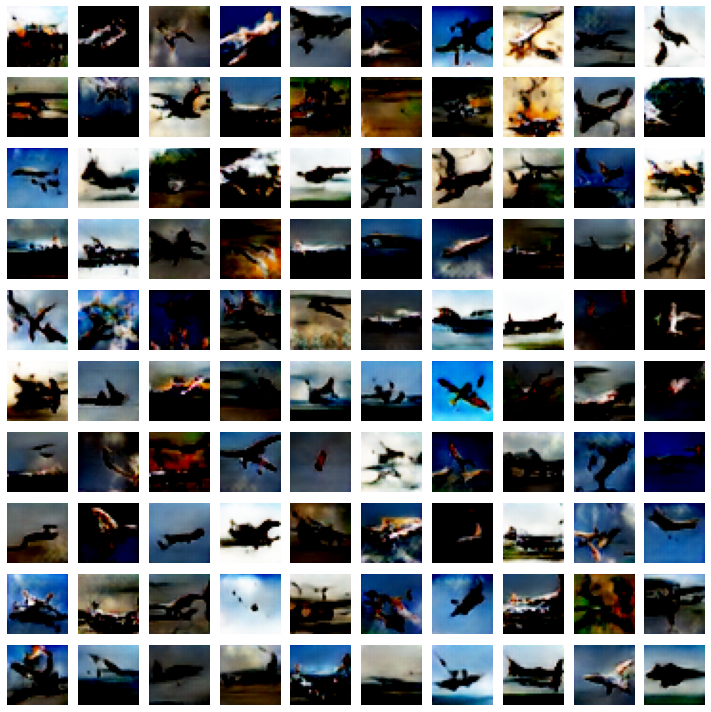

Epoch: 67 	 Discriminator Loss: 0.4687478244304657 		 Generator Loss: 1.4041939973831177
Epoch: 68 	 Discriminator Loss: 0.43994954228401184 		 Generator Loss: 2.4611358642578125


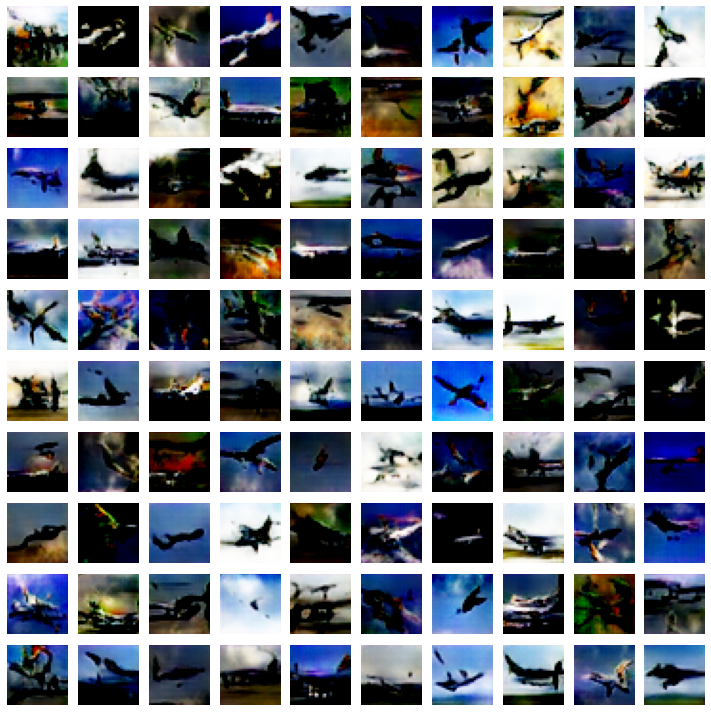

Epoch: 69 	 Discriminator Loss: 0.4705984592437744 		 Generator Loss: 1.5376944541931152
Epoch: 70 	 Discriminator Loss: 0.5177440643310547 		 Generator Loss: 1.6872071027755737


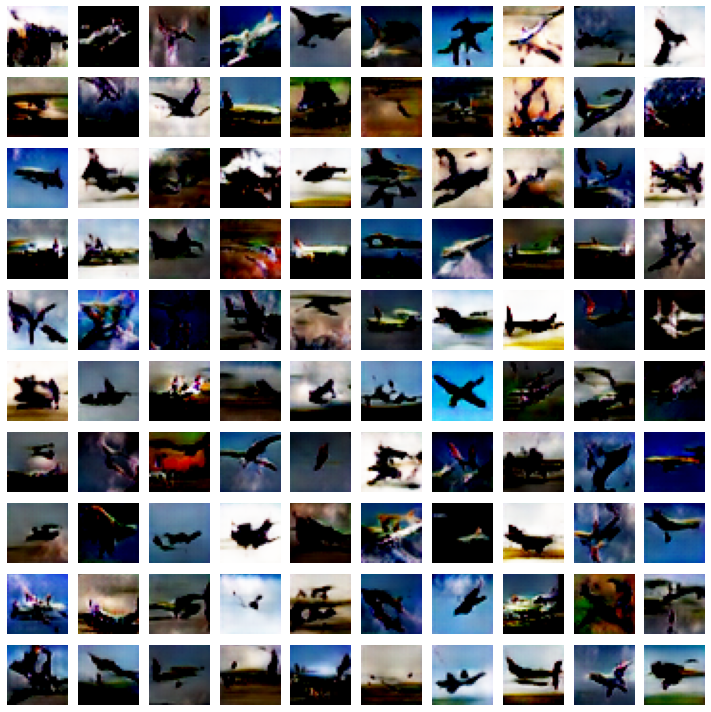

Epoch: 71 	 Discriminator Loss: 0.5969195365905762 		 Generator Loss: 1.5672221183776855
Epoch: 72 	 Discriminator Loss: 0.42394304275512695 		 Generator Loss: 1.7189304828643799


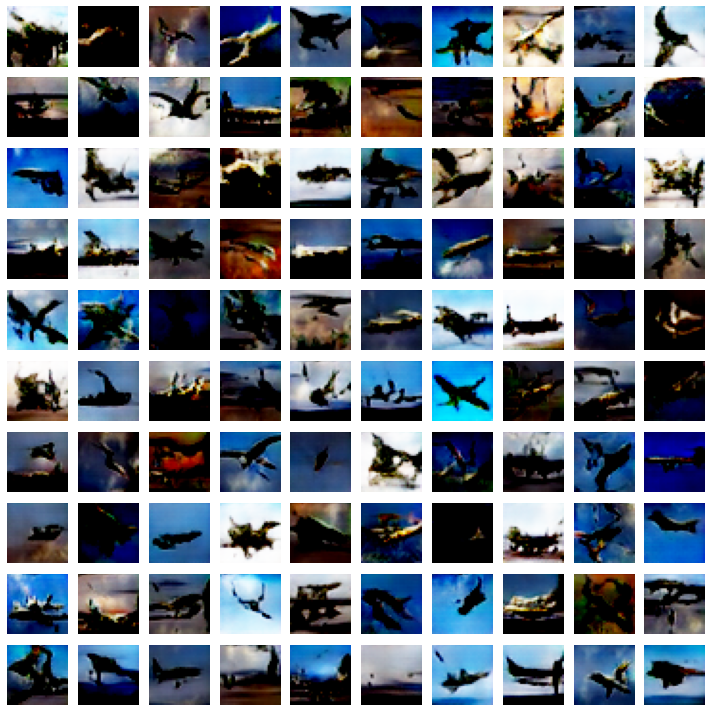

Epoch: 73 	 Discriminator Loss: 0.5937508344650269 		 Generator Loss: 1.2382633686065674
Epoch: 74 	 Discriminator Loss: 0.5122888088226318 		 Generator Loss: 1.4201164245605469


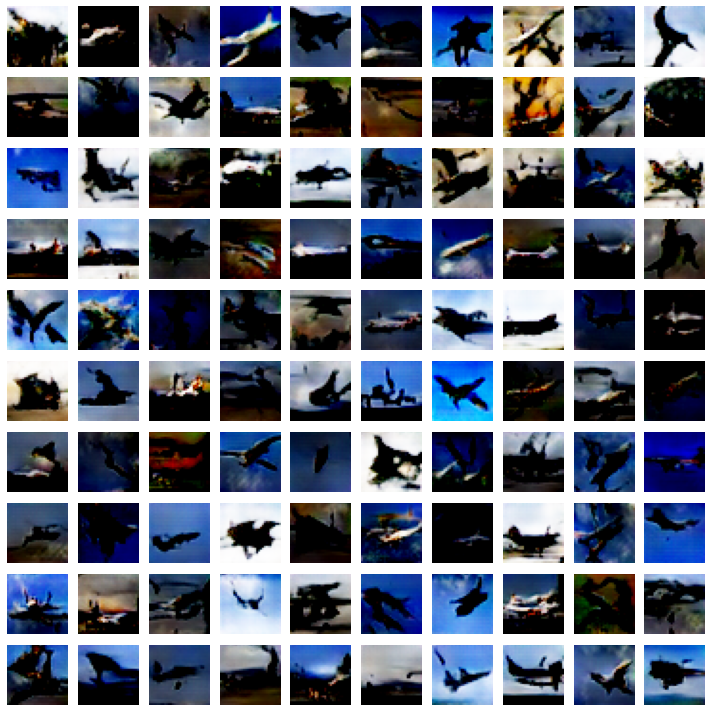

Epoch: 75 	 Discriminator Loss: 0.4827377200126648 		 Generator Loss: 1.314197301864624
Epoch: 76 	 Discriminator Loss: 0.6474814414978027 		 Generator Loss: 2.2601613998413086


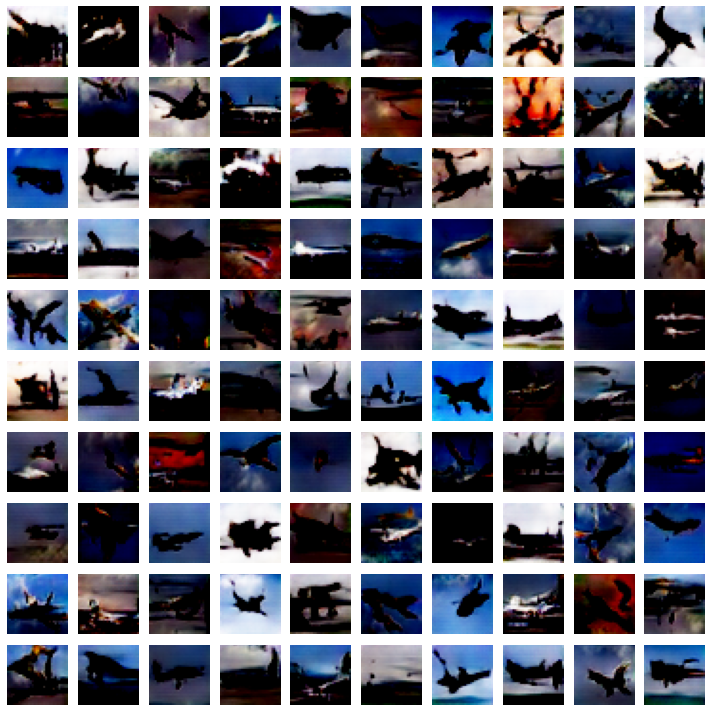

Epoch: 77 	 Discriminator Loss: 0.5068091154098511 		 Generator Loss: 1.6020323038101196
Epoch: 78 	 Discriminator Loss: 0.5392061471939087 		 Generator Loss: 1.5561063289642334


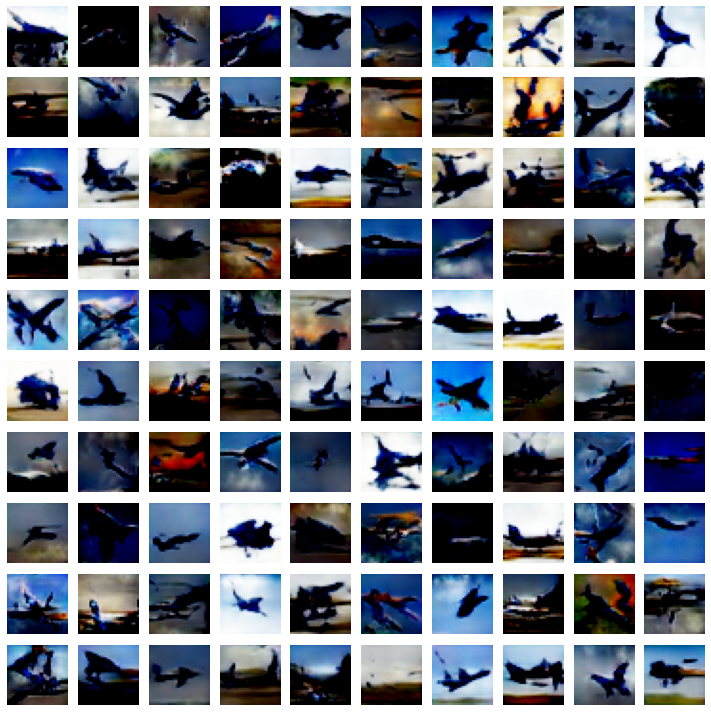

Epoch: 79 	 Discriminator Loss: 0.4174576699733734 		 Generator Loss: 2.0409412384033203
Epoch: 80 	 Discriminator Loss: 0.48338764905929565 		 Generator Loss: 1.667785882949829


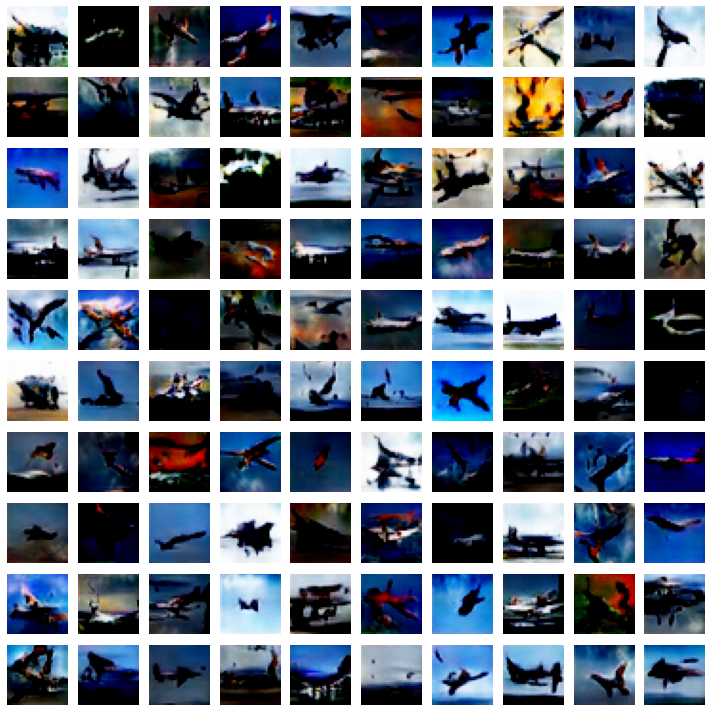

Epoch: 81 	 Discriminator Loss: 0.46842843294143677 		 Generator Loss: 1.5847151279449463
Epoch: 82 	 Discriminator Loss: 0.4697154760360718 		 Generator Loss: 1.7502045631408691


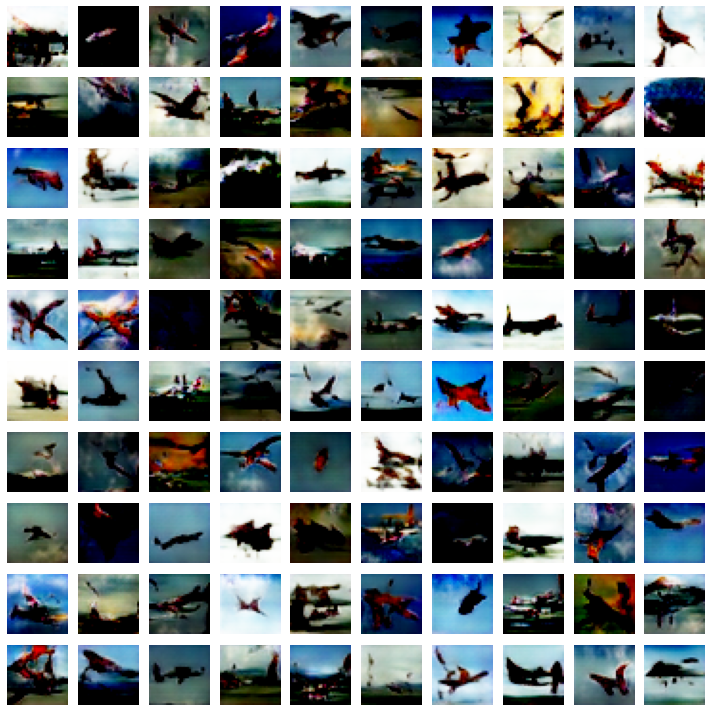

Epoch: 83 	 Discriminator Loss: 0.49345454573631287 		 Generator Loss: 1.5738123655319214
Epoch: 84 	 Discriminator Loss: 0.5014758706092834 		 Generator Loss: 1.7598137855529785


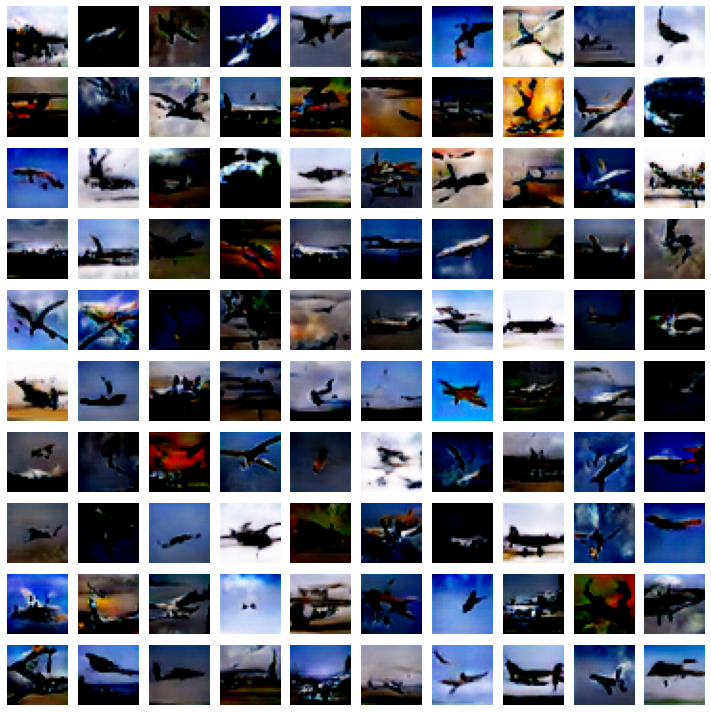

Epoch: 85 	 Discriminator Loss: 0.5462539792060852 		 Generator Loss: 1.841701626777649
Epoch: 86 	 Discriminator Loss: 0.5448043942451477 		 Generator Loss: 1.975964903831482


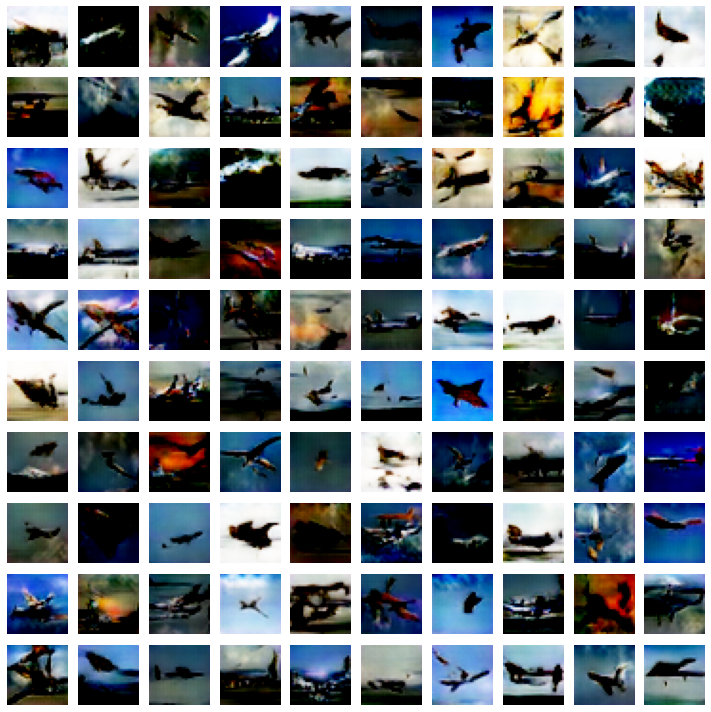

Epoch: 87 	 Discriminator Loss: 0.5200697183609009 		 Generator Loss: 1.692420244216919
Epoch: 88 	 Discriminator Loss: 0.5405268669128418 		 Generator Loss: 2.0496439933776855


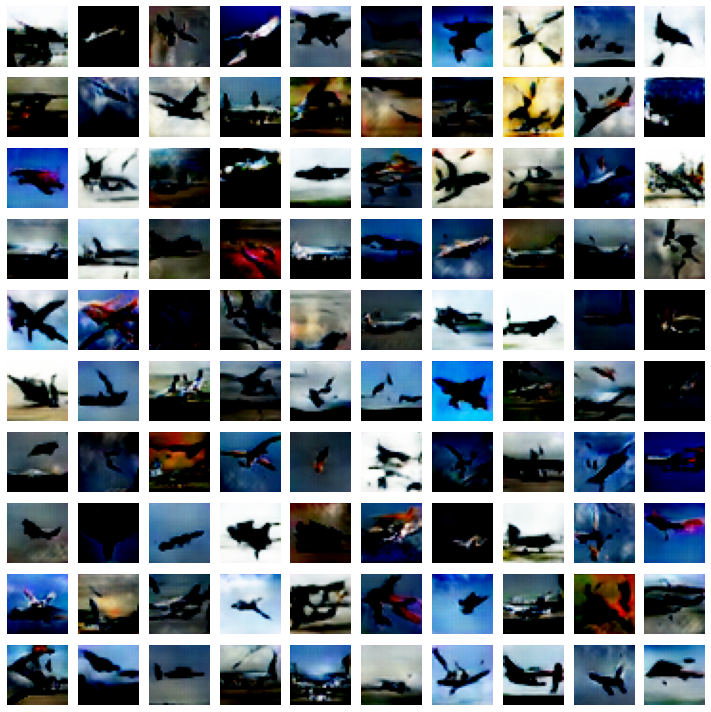

Epoch: 89 	 Discriminator Loss: 0.6794078946113586 		 Generator Loss: 2.13608980178833
Epoch: 90 	 Discriminator Loss: 0.4123152494430542 		 Generator Loss: 1.8880763053894043


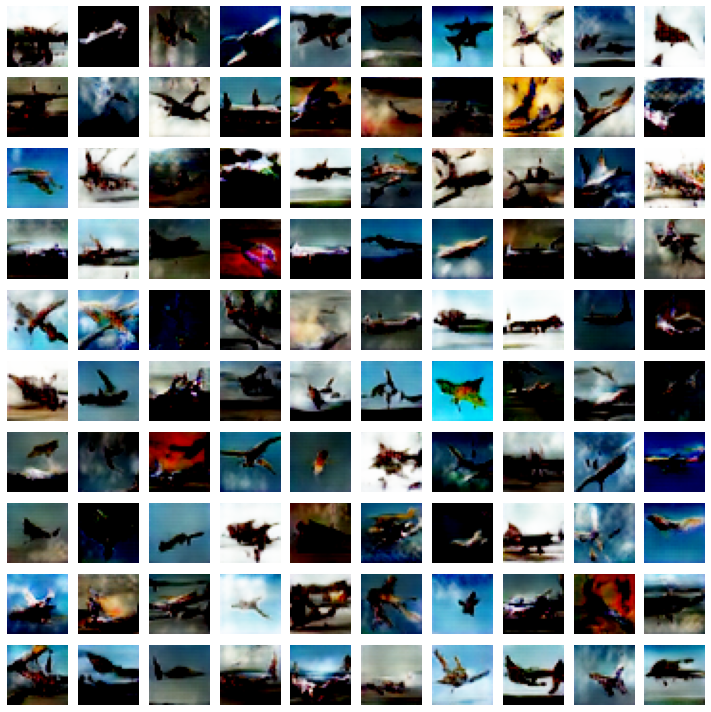

Epoch: 91 	 Discriminator Loss: 0.4249032735824585 		 Generator Loss: 1.991632103919983
Epoch: 92 	 Discriminator Loss: 0.4821694493293762 		 Generator Loss: 2.3379967212677


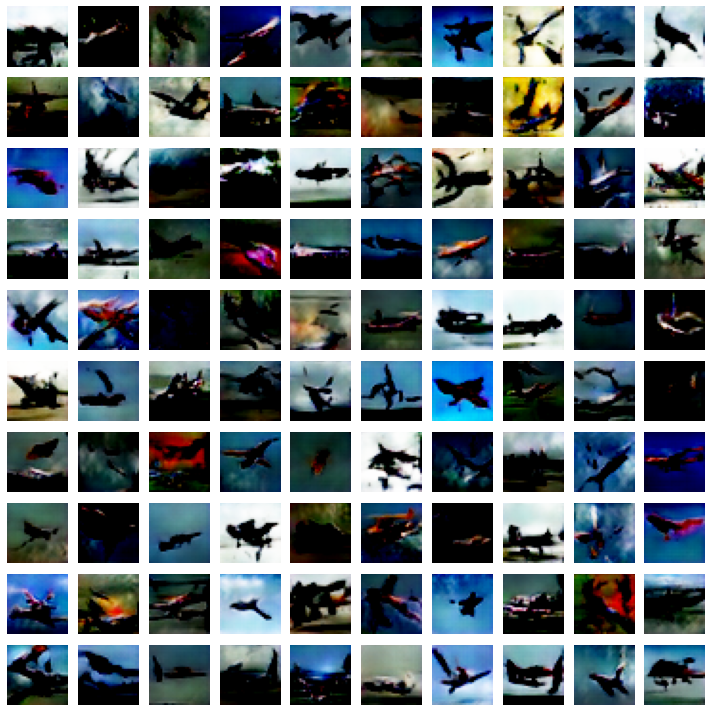

Epoch: 93 	 Discriminator Loss: 0.5172075629234314 		 Generator Loss: 2.3368337154388428
Epoch: 94 	 Discriminator Loss: 0.4702201783657074 		 Generator Loss: 1.9907622337341309


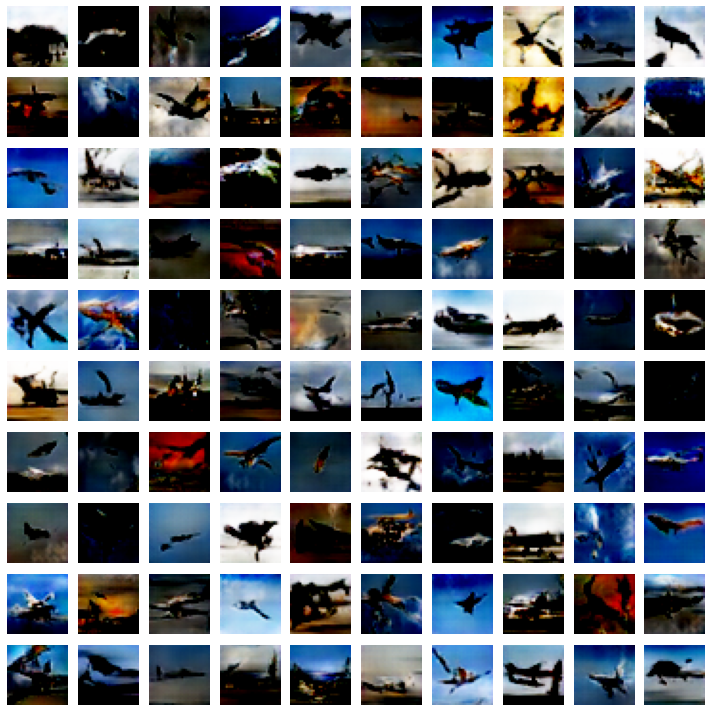

Epoch: 95 	 Discriminator Loss: 0.41782432794570923 		 Generator Loss: 2.440742015838623
Epoch: 96 	 Discriminator Loss: 0.3453965485095978 		 Generator Loss: 1.604554295539856


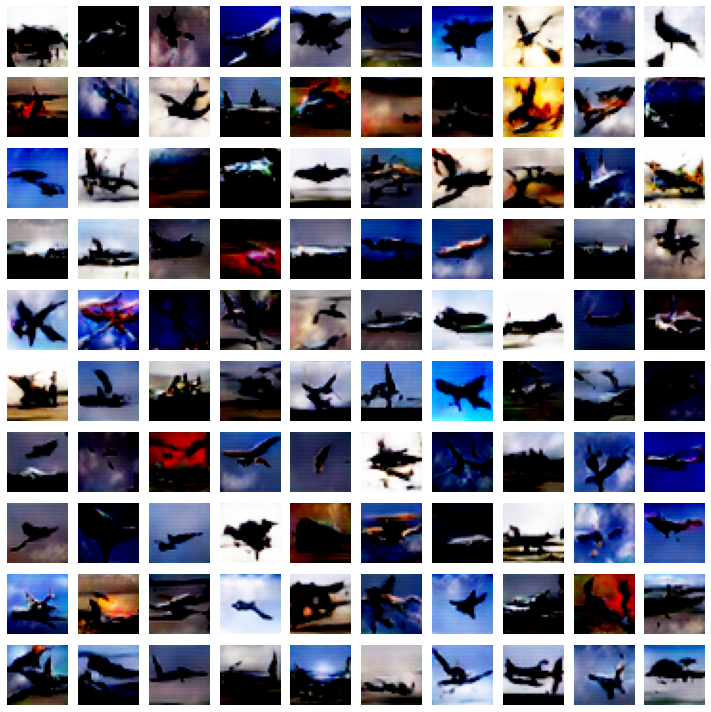

KeyboardInterrupt: 

In [20]:
# Constant noise for viewing how the GAN progresses
static_noise = np.random.normal(0, 1, size=(100, noise_dim))

# Training loop
for epoch in range(epochs):
    for batch in range(steps_per_epoch):
        noise = np.random.normal(0, 1, size=(batch_size, noise_dim))
        real_x = x_train[np.random.randint(0, x_train.shape[0], size=batch_size)]

        fake_x = generator.predict(noise)

        x = np.concatenate((real_x, fake_x))

        disc_y = np.zeros(2*batch_size)
        disc_y[:batch_size] = 0.9

        d_loss = discriminator.train_on_batch(x, disc_y)

        y_gen = np.ones(batch_size)
        g_loss = gan.train_on_batch(noise, y_gen)

    print(f'Epoch: {epoch} \t Discriminator Loss: {d_loss} \t\t Generator Loss: {g_loss}')
    if epoch % 2 == 0:
        show_images(static_noise, epoch)

In [ ]:
# Turn the training process into a GIF
from PIL import Image, ImageDraw

image_names = os.listdir(save_path)

frames = []
for image in sorted(image_names, key=lambda name: int(''.join(i for i in name if i.isdigit()))):
    frames.append(Image.open(save_path + '/' + image))

frames[0].save('gan_training.gif', format='GIF', append_images=frames[1:], save_all=True, duration=80, loop=0)

discriminator.save('dcdiscriminator.h5')
generator.save('dcgenerator.h5')